In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
import scipy.io
import random
import math
import itertools
import pandas as pd

# Naïve Bayes Classifier

# a) Separar los datos

In [2]:
dataDir = "Faces/markings/"
data = []
for file in os.listdir(dataDir) :
    data.append(scipy.io.loadmat(dataDir+file))

In [3]:
neutral = []
indicesneutral = []

happy = []
indiceshappy = []

sad = []
indicessad = []

fear = []
indicesfear = []

angry = []
indicesangry = []

disgust = []
indicesdisgust = []

for file in os.listdir(dataDir):
    if (file[8] == "n"):
        neutral.append(file)
        indicesneutral.append(os.listdir(dataDir).index(file))
    elif (file[8] == "h"):   
        happy.append(file)
        indiceshappy.append(os.listdir(dataDir).index(file))
    elif (file[8] == "s"):
        sad.append(file)
        indicessad.append(os.listdir(dataDir).index(file))
    elif (file[8] == "f"):
        fear.append(file)
        indicesfear.append(os.listdir(dataDir).index(file))
    elif (file[8] == "a"):
        angry.append(file) 
        indicesangry.append(os.listdir(dataDir).index(file))
    elif (file[8] == "d"):
        disgust.append(file)
        indicesdisgust.append(os.listdir(dataDir).index(file))
     

In [4]:
listas = [neutral, happy, sad, fear, angry, disgust]

for lista in listas:
    if (lista == neutral):
        print(f'neutral: {len(lista)} elementos')
    elif (lista == happy):
        print(f'happy: {len(lista)} elementos')
    elif (lista == sad):
        print(f'sad: {len(lista)} elementos')
    elif (lista == fear):
        print(f'fear: {len(lista)} elementos')
    elif (lista == angry):
        print(f'angry: {len(lista)} elementos')
    elif (lista == disgust):
        print(f'disgust: {len(lista)} elementos')

print(f'Total: {len(neutral) + len(happy) + len(sad) + len(fear) + len(angry) + len(disgust)} elementos')

neutral: 163 elementos
happy: 171 elementos
sad: 153 elementos
fear: 170 elementos
angry: 158 elementos
disgust: 159 elementos
Total: 974 elementos


In [5]:
# Ahora vamos a separar los datos en datos de entrenamiento, validación y prueba

numTraining = math.ceil(0.7*len(data))
numValid = math.floor(0.15*len(data))  
numTest = math.floor(0.15*len(data))

print(f'Cantidad de datos de entrenamiento: {numTraining} \n')
print(f'Cantidad de datos de validación: {numValid} \n')
print(f'Cantidad de datos de prueba: {numTest} \n')

files = []
indicesfiles = []

for i in range(len(os.listdir(dataDir))):
    files.append(data[i]['faceCoordinatesUnwarped'])

files_copy = files.copy()

datosNeutral = []
datosHappy = []
datosSad = []
datosFear = []
datosAngry = []
datosDisgust = []

# Creamos listas para guardar los datos de cada clase.
for indice in indicesneutral:
    datosNeutral.append(data[indice]['faceCoordinatesUnwarped'])

for indice in indiceshappy:
    datosHappy.append(data[indice]['faceCoordinatesUnwarped'])

for indice in indicessad:
    datosSad.append(data[indice]['faceCoordinatesUnwarped'])

for indice in indicesfear:
    datosFear.append(data[indice]['faceCoordinatesUnwarped'])

for indice in indicesangry:
    datosAngry.append(data[indice]['faceCoordinatesUnwarped'])

for indice in indicesdisgust:
    datosDisgust.append(data[indice]['faceCoordinatesUnwarped'])

# Creamos las listas donde guardaremos los datos de entrenamiento, validación y prueba
training = []
validation = []
test = []

Cantidad de datos de entrenamiento: 682 

Cantidad de datos de validación: 146 

Cantidad de datos de prueba: 146 



A continuación vamos a llenar la lista de datos de entrenamiento

In [6]:
# Sacamos datos de clase Neutral aleatoriamente para agregarlos a los datos de entrenamiento.
randomNeutral = random.sample(datosNeutral, k=114)
training.append(randomNeutral)

# Lista para guardar los índices de los datos de clase Neutral obtenidos aleatoriamente 
inneutral=[]

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista datosNeutrales).
for i in range(len(datosNeutral)):
    dato = datosNeutral[i]
    for j in range(len(randomNeutral)):
        comparison = (dato == randomNeutral[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inneutral.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
neutral_sin_training = [i for j, i in enumerate(datosNeutral) if j not in inneutral]

##########################################################################################

randomHappy = random.sample(datosHappy, k=114)
training.append(randomHappy)

# Lista para guardar los índices de los datos de clase Happy obtenidos aleatoriamente 
inHappy = []

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista datosHappy).
for i in range(len(datosHappy)):
    dato = datosHappy[i]
    for j in range(len(randomHappy)):
        comparison = (dato == randomHappy[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inHappy.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
happy_sin_training = [i for j, i in enumerate(datosHappy) if j not in inHappy]

##########################################################################################

randomSad = random.sample(datosSad, k=114)
training.append(randomSad)

# Lista para guardar los índices de los datos de clase Sad obtenidos aleatoriamente 
inSad = []

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista datosSad).
for i in range(len(datosSad)):
    dato = datosSad[i]
    for j in range(len(randomSad)):
        comparison = (dato == randomSad[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inSad.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
sad_sin_training = [i for j, i in enumerate(datosSad) if j not in inSad]


##########################################################################################

randomFear = random.sample(datosFear, k=114)
training.append(randomFear)

# Lista para guardar los índices de los datos de clase Fear obtenidos aleatoriamente 
inFear = []

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista datosFear).
for i in range(len(datosFear)):
    dato = datosFear[i]
    for j in range(len(randomFear)):
        comparison = (dato == randomFear[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inFear.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
fear_sin_training = [i for j, i in enumerate(datosFear) if j not in inFear]

##########################################################################################

randomAngry = random.sample(datosAngry, k=113)
training.append(randomAngry)

# Lista para guardar los índices de los datos de clase Angry obtenidos aleatoriamente 
inAngry = []

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista datosAngry).
for i in range(len(datosAngry)):
    dato = datosAngry[i]
    for j in range(len(randomAngry)):
        comparison = (dato == randomAngry[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inAngry.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
angry_sin_training = [i for j, i in enumerate(datosAngry) if j not in inAngry]

##########################################################################################

randomDisgust = random.sample(datosDisgust, k=113)
training.append(randomDisgust)

# Lista para guardar los índices de los datos de clase Disgust obtenidos aleatoriamente 
inDisgust = []

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista datosDisgust).
for i in range(len(datosDisgust)):
    dato = datosDisgust[i]
    for j in range(len(randomDisgust)):
        comparison = (dato == randomDisgust[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inDisgust.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
disgust_sin_training = [i for j, i in enumerate(datosDisgust) if j not in inDisgust]

##########################################################################################

# Esta línea es para que no nos quede una lista de 6 listas, sino solo una lista con todos los datos
training = list(itertools.chain.from_iterable(training))

Ahora vamos a llenar la lista de datos de validación

In [7]:
# Sacamos datos de clase Neutral aleatoriamente para agregarlos a los datos de validación.
randomNeutral_v = random.sample(neutral_sin_training, k=25)
validation.append(randomNeutral_v)

# Lista para guardar los índices de los datos de clase Neutral obtenidos aleatoriamente 
inneutral_v = []

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista neutral_sin_training).
for i in range(len(neutral_sin_training)):
    dato = neutral_sin_training[i]
    for j in range(len(randomNeutral_v)):
        comparison = (dato == randomNeutral_v[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inneutral_v.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
neutral_sin_training_y_val = [i for j, i in enumerate(neutral_sin_training) if j not in inneutral_v]

##########################################################################################

randomHappy_v = random.sample(happy_sin_training, k=30)
validation.append(randomHappy_v)

# Lista para guardar los índices de los datos de clase Happy obtenidos aleatoriamente 
inHappy_v = []

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista happy_sin_training).
for i in range(len(happy_sin_training)):
    dato = happy_sin_training[i]
    for j in range(len(randomHappy_v)):
        comparison = (dato == randomHappy_v[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inHappy_v.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
happy_sin_training_y_val = [i for j, i in enumerate(happy_sin_training) if j not in inHappy_v]

##########################################################################################

randomSad_v = random.sample(sad_sin_training, k=19)
validation.append(randomSad_v)

# Lista para guardar los índices de los datos de clase Sad obtenidos aleatoriamente 
inSad_v = []

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista sad_sin_training).
for i in range(len(sad_sin_training)):
    dato = sad_sin_training[i]
    for j in range(len(randomSad_v)):
        comparison = (dato == randomSad_v[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inSad_v.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
sad_sin_training_y_val = [i for j, i in enumerate(sad_sin_training) if j not in inSad_v]

##########################################################################################

randomFear_v = random.sample(fear_sin_training, k=26)
validation.append(randomFear_v)

# Lista para guardar los índices de los datos de clase Fear obtenidos aleatoriamente 
inFear_v = []

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista sad_sin_training).
for i in range(len(fear_sin_training)):
    dato = fear_sin_training[i]
    for j in range(len(randomFear_v)):
        comparison = (dato == randomFear_v[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inFear_v.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
fear_sin_training_y_val = [i for j, i in enumerate(fear_sin_training) if j not in inFear_v]

##########################################################################################

randomAngry_v = random.sample(angry_sin_training, k=23)
validation.append(randomAngry_v)

# Lista para guardar los índices de los datos de clase Angry obtenidos aleatoriamente 
inAngry_v = []

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista sad_sin_training).
for i in range(len(angry_sin_training)):
    dato = angry_sin_training[i]
    for j in range(len(randomAngry_v)):
        comparison = (dato == randomAngry_v[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inAngry_v.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
angry_sin_training_y_val = [i for j, i in enumerate(angry_sin_training) if j not in inAngry_v]

##########################################################################################

randomDisgust_v = random.sample(disgust_sin_training, k=23)
validation.append(randomDisgust_v)

# Lista para guardar los índices de los datos de clase Angry obtenidos aleatoriamente 
inDisgust_v = []

# Obtenemos los índices de los elementos aleatorios que acabamos de generar (dentro de la lista sad_sin_training).
for i in range(len(disgust_sin_training)):
    dato = disgust_sin_training[i]
    for j in range(len(randomDisgust_v)):
        comparison = (dato == randomDisgust_v[j])
        equal_arrays = comparison.all()
        if equal_arrays == True:
            inDisgust_v.append(i)

# Creamos una lista nueva que no incluye los datos cuyos índices tocaba borrar.
disgust_sin_training_y_val = [i for j, i in enumerate(disgust_sin_training) if j not in inDisgust_v]

##########################################################################################

# Esta línea es para que no nos quede una lista de 6 listas, sino solo una lista con todos los datos
validation = list(itertools.chain.from_iterable(validation))

Ahora vamos a llenar la lista de datos de prueba

In [8]:
# Al conjunto de datos de prueba solo se le agregan los datos que sobran.

test.append(random.sample(neutral_sin_training_y_val, k=24))
test.append(random.sample(happy_sin_training_y_val, k=27))
test.append(random.sample(sad_sin_training_y_val, k=20))  
test.append(random.sample(fear_sin_training_y_val, k=30))   
test.append(random.sample(angry_sin_training_y_val, k=22))
test.append(random.sample(disgust_sin_training_y_val, k=23))

# Esta línea es para que no nos quede una lista de 6 listas, sino solo una lista con todos los datos
test = list(itertools.chain.from_iterable(test))

In [9]:
print(f'Cantidad de datos de entrenamiento: {len(training)}')
print(f'Cantidad de datos de validación: {len(validation)}')
print(f'Cantidad de datos de prueba: {len(test)}')

Cantidad de datos de entrenamiento: 682
Cantidad de datos de validación: 146
Cantidad de datos de prueba: 146


# b) Calcular la media de Procrustes

Text(0, 0.5, 'y')

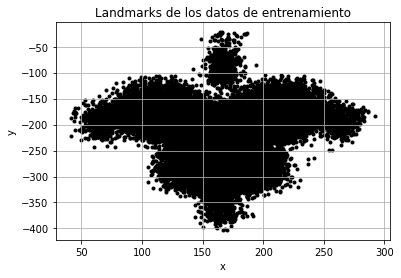

In [10]:
# Vamos a usar solamente los datos de entrenamiento para calcular la media de Procrustes

plt.figure()
plt.grid()
for i in range(len(training)):
    plt.scatter(training[i][:,0], -training[i][:,1], color='black', marker='.')
plt.title('Landmarks de los datos de entrenamiento')
plt.xlabel('x')
plt.ylabel('y')

Text(0, 0.5, 'y')

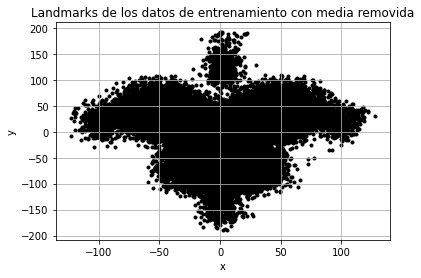

In [11]:
train = np.vstack(training)

# Parte real de los datos (coordsX)
wr = np.array(np.matrix(train[:,0])).T

# Parte imaginaria de los datos (coordsY)
wi = np.array(np.matrix(train[:,1])).T

# Se remueve la media de cada forma
mediaWr = float(sum(wr))/len(wr)
mediaWi = float(sum(wi))/len(wi)

wr_sinmedia = wr - mediaWr
wi_sinmedia = wi - mediaWi


# Graficamos los landmarks con la media removida

plt.figure()
plt.grid()
plt.scatter(wr_sinmedia, -wi_sinmedia, color='black', marker='.')
plt.title('Landmarks de los datos de entrenamiento con media removida')
plt.xlabel('x')
plt.ylabel('y')

In [12]:
# Ahora vamos a encontrar la media de Procrustes
S = np.zeros((len(training[0]), len(training[0])))
w_complejo = np.zeros((len(training[0]), 1), dtype=complex)

# Construimos la matriz S
primero = 1
for i in range(len(training)):
    dato = training[i]
    for j in range(len(dato)):
        w_complejo[j] = complex(dato[j][0], dato[j][1])
    if primero==1:
        S = w_complejo@np.transpose(np.conj(w_complejo))
        primero = 0
    else:
        S = S + w_complejo@np.transpose(np.conj(w_complejo))

print(np.shape(S))

(67, 67)


Text(0, 0.5, 'y')

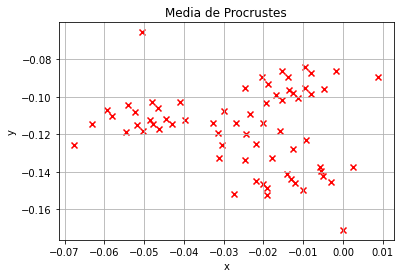

In [13]:
from numpy import linalg as LA

# w es un arreglo con los valores propios
# v es una matriz cuyas columnas son los vectores propios
# el valor propio en w[i] está asociado a la columna v[:,i]
w, v = LA.eig(S)

maximo = np.abs(np.amax(w))
indice = 0

for i in range(len(w)):
    if np.abs(w[i]) == maximo:
        indice = i

# Media de Procrustes
mediaProc = v[:, indice]
coordsX = mediaProc.real
coordsY = mediaProc.imag

plt.figure()
plt.grid()
plt.scatter(coordsY, -coordsX, color='red', marker='x')
plt.title('Media de Procrustes')
plt.xlabel('x')
plt.ylabel('y')

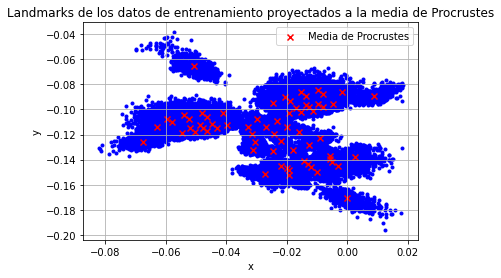

In [14]:
# Ahora vamos a alinear los landmarks de los datos de entrenamineto, validación y prueba a la media de Procrustes.

################# Datos de entrenamiento ###############

# Creamos una lista para guardar en ella los datos ajustados a la media de Procrustes
training_media = []

# Este es el vector que vamos a ajustar a la media de Procrustes
w_tr_comp = np.zeros((len(training[0]), 1), dtype=complex)

for i in range(len(training)):
    dato = training[i]
    for j in range(len(dato)):
        w_tr_comp[j] = complex(dato[j][0], dato[j][1])

    wp_tr = w_tr_comp*((np.transpose(np.conj(w_tr_comp))@mediaProc)/((np.transpose(np.conj(w_tr_comp))@w_tr_comp)))
    training_media.append(wp_tr)

    # Separamos las coordenadas X y las coordenadas Y
    wp_tr_r = wp_tr.real
    wp_tr_i = wp_tr.imag

    # Gráfica
    plt.scatter(wp_tr_i, -wp_tr_r, color='blue', marker='.')

plt.grid()
plt.scatter(coordsY, -coordsX, color='red', marker='x', label='Media de Procrustes')
plt.title('Landmarks de los datos de entrenamiento proyectados a la media de Procrustes')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()

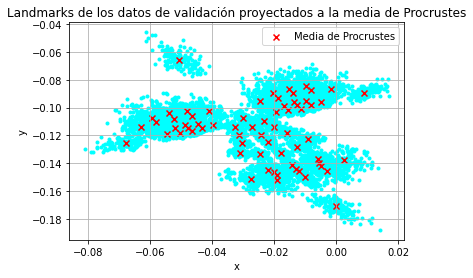

In [15]:
################# Datos de validación ##################

# Creamos una lista para guardar en ella los datos ajustados a la media de Procrustes
validation_media = []

# Este es el vector que vamos a ajustar a la media de Procrustes
w_val_comp = np.zeros((len(validation[0]), 1), dtype=complex)

for i in range(len(validation)):
    dato = validation[i]
    for j in range(len(dato)):
        w_val_comp[j] = complex(dato[j][0], dato[j][1])

    wp_val = w_val_comp*((np.transpose(np.conj(w_val_comp))@mediaProc)/((np.transpose(np.conj(w_val_comp))@w_val_comp)))
    validation_media.append(wp_val)

    # Separamos las coordenadas X y las coordenadas Y
    wp_val_r = wp_val.real
    wp_val_i = wp_val.imag

    # Gráfica
    plt.scatter(wp_val_i, -wp_val_r, color='cyan', marker='.')

plt.grid()
plt.scatter(coordsY, -coordsX, color='red', marker='x', label='Media de Procrustes')
plt.title('Landmarks de los datos de validación proyectados a la media de Procrustes')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()

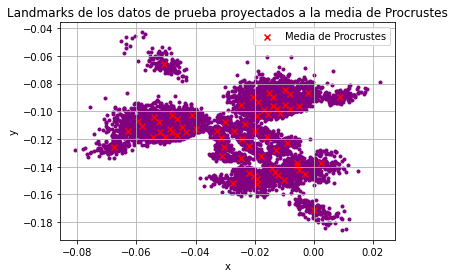

In [16]:
################# Datos de prueba ######################

# Creamos una lista para guardar en ella los datos ajustados a la media de Procrustes
test_media = []

# Este es el vector que vamos a ajustar a la media de Procrustes
w_test_comp = np.zeros((len(test[0]), 1), dtype=complex)

for i in range(len(test)):
    dato = test[i]
    for j in range(len(dato)):
        w_test_comp[j] = complex(dato[j][0], dato[j][1])

    wp_test = w_test_comp*((np.transpose(np.conj(w_test_comp))@mediaProc)/((np.transpose(np.conj(w_test_comp))@w_test_comp)))
    test_media.append(wp_test)

    # Separamos las coordenadas X y las coordenadas Y
    wp_test_r = wp_test.real
    wp_test_i = wp_test.imag

    # Gráfica
    plt.scatter(wp_test_i, -wp_test_r, color='purple', marker='.')

plt.grid()
plt.scatter(coordsY, -coordsX, color='red', marker='x', label='Media de Procrustes')
plt.title('Landmarks de los datos de prueba proyectados a la media de Procrustes')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()

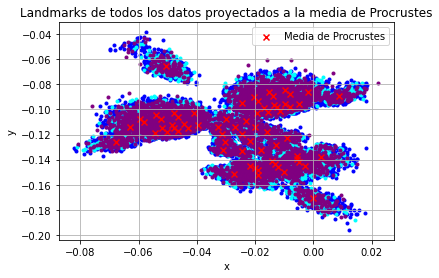

In [17]:
################# Todos los datos ######################
todos = list(itertools.chain(training, validation, test))

# Este es el vector que vamos a ajustar a la media de Procrustes
w_todos_comp = np.zeros((len(todos[0]), 1), dtype=complex)

for i in range(len(todos)):
    dato = todos[i]
    for j in range(len(dato)):
        w_todos_comp[j] = complex(dato[j][0], dato[j][1])

    wp_todos = w_todos_comp*((np.transpose(np.conj(w_todos_comp))@mediaProc)/((np.transpose(np.conj(w_todos_comp))@w_todos_comp)))

    # Separamos las coordenadas X y las coordenadas Y
    wp_todos_r = wp_todos.real
    wp_todos_i = wp_todos.imag

    # Gráfica
    if i < len(training):
        plt.scatter(wp_todos_i, -wp_todos_r, color='blue', marker='.')
    elif i > len(training) and i < len(training) + len(validation):
        plt.scatter(wp_todos_i, -wp_todos_r, color='cyan', marker='.')
    elif i > len(training) + len(validation) and i < len(training) + len(validation) + len(test):
        plt.scatter(wp_todos_i, -wp_todos_r, color='purple', marker='.')

plt.grid()
plt.scatter(coordsY, -coordsX, color='red', marker='x', label='Media de Procrustes')
plt.title('Landmarks de todos los datos proyectados a la media de Procrustes')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()

# c) Con los landmarks alineados, cree un vector de características de tamaño 2n por cada expresión facial en todos los conjuntos (n el tamaño de cada cara).

Las primeras n características corresponden a las componentes horizontales de los landmarks de la expresión facial, y las n características siguientes corresponden a las componentes verticales de los landmarks de la expresión facial.

### Datos de entrenamiento

In [18]:
# Dentro de los datos de entrenamiento, los primeros 114 corresponden a neutral, los siguientes 114 corresponden a happy, los siguientes 114 corresponden a sad, los siguientes 114 corresponden a fear, los siguientes 113 corresponden a angry y los últimos 113 corresponden a disgust

# Creamos los contadores para saber en qué parte de la lista de entrenamiento se encuentran los datos correspondientes a cada clase.
cNeutral_tr = 114
cHappy_tr = cNeutral_tr + 114
cSad_tr = cHappy_tr + 114
cFear_tr = cSad_tr + 114
cAngry_tr = cFear_tr + 113
cDisgust_tr = cAngry_tr  + 113

numNeu_tr = cNeutral_tr
numHappy_tr = cHappy_tr-cNeutral_tr
numSad_tr = cSad_tr-cHappy_tr
numFear_tr = cFear_tr-cSad_tr
numAngry_tr = cAngry_tr-cFear_tr
numDisgust_tr = cDisgust_tr-cAngry_tr

# Se crean 6 matrices de tamaño (2n = 134)x(numDatos_clase): uno para cada clase 
vNeutral_train = np.zeros((2*len(training_media[0]), numNeu_tr))
vHappy_train = np.zeros((2*len(training_media[0]), numHappy_tr))
vSad_train = np.zeros((2*len(training_media[0]), numSad_tr))
vFear_train = np.zeros((2*len(training_media[0]), numFear_tr))
vAngry_train = np.zeros((2*len(training_media[0]), numAngry_tr))
vDisgust_train = np.zeros((2*len(training_media[0]), numDisgust_tr))

# Recorremos la cantidad de datos de entrenamiento que tengamos (en este caso 682) y vamos preguntando en qué rango de datos nos encontramos con ayuda de los contadores creados arriba. Dependiendo del rango se sabe en qué clase nos encontramos. Vamos llenando el vector correspondiente a cada clase con las coordsX (parte real) y coordsY (parte imaginaria).
for i in range(len(training_media)):
    dato = training_media[i]
    datoNew = np.vstack((dato.real, dato.imag))
    if i < cNeutral_tr:
        vNeutral_train[:,i] = np.array(np.matrix(datoNew)).T
    elif i >= cNeutral_tr and i < cHappy_tr:
        k = i - cNeutral_tr
        vHappy_train[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cHappy_tr and i < cSad_tr:
        k = i - cHappy_tr
        vSad_train[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cSad_tr and i < cFear_tr:
        k = i - cSad_tr
        vFear_train[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cFear_tr and i < cAngry_tr:
        k = i - cFear_tr
        vAngry_train[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cAngry_tr and i < cDisgust_tr:
        k = i - cAngry_tr
        vDisgust_train[:,k] = np.array(np.matrix(datoNew)).T


### Datos de validación

In [19]:
# Creamos los contadores para saber en qué parte de la lista de validación se encuentran los datos correspondientes a cada clase.
cNeutral_val = 25
cHappy_val = cNeutral_val + 30
cSad_val = cHappy_val + 19
cFear_val = cSad_val + 26
cAngry_val = cFear_val + 23
cDisgust_val = cAngry_val  + 23

numNeu_val = cNeutral_val
numHappy_val = cHappy_val-cNeutral_val
numSad_val = cSad_val-cHappy_val
numFear_val = cFear_val-cSad_val
numAngry_val = cAngry_val-cFear_val
numDisgust_val = cDisgust_val-cAngry_val

# Se crean 6 matrices de tamaño (2n = 134)x(numDatos_clase): uno para cada clase 
vNeutral_val = np.zeros((2*len(validation_media[0]), numNeu_val))
vHappy_val = np.zeros((2*len(validation_media[0]), numHappy_val))
vSad_val = np.zeros((2*len(validation_media[0]), numSad_val))
vFear_val = np.zeros((2*len(validation_media[0]), numFear_val))
vAngry_val = np.zeros((2*len(validation_media[0]), numAngry_val))
vDisgust_val = np.zeros((2*len(validation_media[0]), numDisgust_val))

# Recorremos la cantidad de datos de validación que tengamos (en este caso 146) y vamos preguntando en qué rango de datos nos encontramos con ayuda de los contadores creados arriba. Dependiendo del rango se sabe en qué clase nos encontramos. Vamos llenando el vector correspondiente a cada clase con las coordsX (parte real) y coordsY (parte imaginaria).
for i in range(len(validation_media)):
    dato = validation_media[i]
    datoNew = np.vstack((dato.real, dato.imag))
    if i < cNeutral_val:
        vNeutral_val[:,i] = np.array(np.matrix(datoNew)).T
    elif i >= cNeutral_val and i < cHappy_val:
        k = i - cNeutral_val
        vHappy_val[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cHappy_val and i < cSad_val:
        k = i - cHappy_val
        vSad_val[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cSad_val and i < cFear_val:
        k = i - cSad_val
        vFear_val[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cFear_val and i < cAngry_val:
        k = i - cFear_val
        vAngry_val[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cAngry_val and i < cDisgust_val:
        k = i - cAngry_val
        vDisgust_val[:,k] = np.array(np.matrix(datoNew)).T

### Datos de prueba

In [20]:
# Creamos los contadores para saber en qué parte de la lista de prueba se encuentran los datos correspondientes a cada clase.
cNeutral_test = 24
cHappy_test = cNeutral_test + 27
cSad_test = cHappy_test + 20
cFear_test = cSad_test + 30
cAngry_test = cFear_test + 22
cDisgust_test = cAngry_test  + 23

numNeu_test = cNeutral_test
numHappy_test = cHappy_test-cNeutral_test
numSad_test = cSad_test-cHappy_test
numFear_test = cFear_test-cSad_test
numAngry_test = cAngry_test-cFear_test
numDisgust_test = cDisgust_test-cAngry_test

# Se crean 6 matrices de tamaño (2n = 134)x(numDatos_clase): uno para cada clase 
vNeutral_test = np.zeros((2*len(test_media[0]), numNeu_test))
vHappy_test = np.zeros((2*len(test_media[0]), numHappy_test))
vSad_test = np.zeros((2*len(test_media[0]), numSad_test))
vFear_test = np.zeros((2*len(test_media[0]), numFear_test))
vAngry_test = np.zeros((2*len(test_media[0]), numAngry_test))
vDisgust_test = np.zeros((2*len(test_media[0]), numDisgust_test))

# Recorremos la cantidad de datos de prueba que tengamos (en este caso 146) y vamos preguntando en qué rango de datos nos encontramos con ayuda de los contadores creados arriba. Dependiendo del rango se sabe en qué clase nos encontramos. Vamos llenando el vector correspondiente a cada clase con las coordsX (parte real) y coordsY (parte imaginaria).
for i in range(len(test_media)):
    dato = test_media[i]
    datoNew = np.vstack((dato.real, dato.imag))
    if i < cNeutral_test:
        vNeutral_test[:,i] = np.array(np.matrix(datoNew)).T
    elif i >= cNeutral_test and i < cHappy_test:
        k = i - cNeutral_test
        vHappy_test[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cHappy_test and i < cSad_test:
        k = i - cHappy_test
        vSad_test[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cSad_test and i < cFear_test:
        k = i - cSad_test
        vFear_test[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cFear_test and i < cAngry_test:
        k = i - cFear_test
        vAngry_test[:,k] = np.array(np.matrix(datoNew)).T
    elif i >= cAngry_test and i < cDisgust_test:
        k = i - cAngry_test
        vDisgust_test[:,k] = np.array(np.matrix(datoNew)).T


# d) Gaussian Naive Bayes Classifier

Con los datos de entrenamiento, estime la media y la matriz de covarianza para cada clase (es decir, debe haber un vector de medias y una matriz de covarianza por clase). No pueden utilizar funciones preestablecidas para estimar la media y matriz de covarianza. Estime el likelihood de los datos (es decir, la función de distribución) por cada clase asumiendo que son Gaussianos con las medias y covarianzas estimadas. Asuma que las clases tienen igual probabilidad a priori.

Agregar regularización a la matriz de covarianza de cada clase.

$$ \mu_c = \frac{1}{m_c} \sum_{i=1}^{m_c} x_i $$
$$ C_c =  \frac{1}{m_c} \sum_{i=1}^{m_c} (x_i - \mu_c)(x_i - \mu_c)^T $$

$m_c$ es el múmero de datos de la clase $c$ y $x_i$ es un vector de características

In [21]:
def gauss(x, mu, Cx):
    n = np.shape(Cx)[0]
    return (1/(np.sqrt((2*np.pi)**(n)*(np.linalg.det(Cx)))))*np.exp((-1/2)*(np.transpose(x-mu)@np.linalg.inv(Cx))@(x-mu))

Solo vamos a usar los datos de entrenamiento

In [22]:
# Calculamos las medias de cada clase

mu_neutral = np.zeros((np.shape(vNeutral_train)[0],1))
mu_happy = np.zeros((np.shape(vHappy_train)[0],1))
mu_sad = np.zeros((np.shape(vSad_train)[0],1))
mu_fear = np.zeros((np.shape(vFear_train)[0],1))
mu_angry = np.zeros((np.shape(vAngry_train)[0],1))
mu_disgust = np.zeros((np.shape(vDisgust_train)[0],1))

for i in range(np.shape(vNeutral_train)[1]):
    xi = np.array(np.matrix(vNeutral_train[:,i])).T
    mu_neutral = mu_neutral + xi

mu_neutral = mu_neutral/np.shape(vNeutral_train)[1]

for i in range(np.shape(vHappy_train)[1]):
    xi = np.array(np.matrix(vHappy_train[:,i])).T
    mu_happy = mu_happy + xi

mu_happy = mu_happy/np.shape(vHappy_train)[1]

for i in range(np.shape(vSad_train)[1]):
    xi = np.array(np.matrix(vSad_train[:,i])).T
    mu_sad = mu_sad + xi

mu_sad = mu_sad/np.shape(vSad_train)[1]

for i in range(np.shape(vFear_train)[1]):
    xi = np.array(np.matrix(vFear_train[:,i])).T
    mu_fear = mu_fear + xi

mu_fear = mu_fear/np.shape(vFear_train)[1]

for i in range(np.shape(vAngry_train)[1]):
    xi = np.array(np.matrix(vAngry_train[:,i])).T
    mu_angry = mu_angry + xi

mu_angry = mu_angry/np.shape(vAngry_train)[1]

for i in range(np.shape(vDisgust_train)[1]):
    xi = np.array(np.matrix(vDisgust_train[:,i])).T
    mu_disgust = mu_disgust + xi

mu_disgust = mu_disgust/np.shape(vDisgust_train)[1]


# print(f'mu_neutral:\n {mu_neutral}\n')
# print(f'mu_happy:\n {mu_happy}\n')
# print(f'mu_sad:\n {mu_sad}\n')
# print(f'mu_fear:\n {mu_fear}\n')
# print(f'mu_angry:\n {mu_angry}\n')
# print(f'mu_disgust:\n {mu_disgust}\n')

In [23]:
# Calculamos las matrices de covarianza

C_neutral = np.zeros((np.shape(vNeutral_train)[0], np.shape(vNeutral_train)[0]))
C_happy = np.zeros((np.shape(vHappy_train)[0], np.shape(vHappy_train)[0]))
C_sad = np.zeros((np.shape(vSad_train)[0], np.shape(vSad_train)[0]))
C_fear = np.zeros((np.shape(vFear_train)[0], np.shape(vFear_train)[0]))
C_angry = np.zeros((np.shape(vAngry_train)[0], np.shape(vAngry_train)[0]))
C_disgust = np.zeros((np.shape(vDisgust_train)[0], np.shape(vDisgust_train)[0]))

# Regularización

val = 0.0
regu = val*np.eye(np.shape(vNeutral_train)[0])

for i in range(np.shape(vNeutral_train)[1]):
    xi = np.array(np.matrix(vNeutral_train[:,i])).T
    C_neutral = C_neutral + (xi-mu_neutral)@(xi-mu_neutral).T

C_neutral = C_neutral/np.shape(vNeutral_train)[1] + regu

for i in range(np.shape(vHappy_train)[1]):
    xi = np.array(np.matrix(vHappy_train[:,i])).T
    C_happy = C_happy + (xi-mu_happy)@(xi-mu_happy).T

C_happy = C_happy/np.shape(vHappy_train)[1] + regu

for i in range(np.shape(vSad_train)[1]):
    xi = np.array(np.matrix(vSad_train[:,i])).T
    C_sad = C_sad + (xi-mu_sad)@(xi-mu_sad).T

C_sad = C_sad/np.shape(vSad_train)[1] + regu

for i in range(np.shape(vFear_train)[1]):
    xi = np.array(np.matrix(vFear_train[:,i])).T
    C_fear = C_fear + (xi-mu_fear)@(xi-mu_fear).T

C_fear = C_fear/np.shape(vFear_train)[1] + regu

for i in range(np.shape(vAngry_train)[1]):
    xi = np.array(np.matrix(vAngry_train[:,i])).T
    C_angry = C_angry + (xi-mu_angry)@(xi-mu_angry).T

C_angry = C_angry/np.shape(vAngry_train)[1] + regu

for i in range(np.shape(vDisgust_train)[1]):
    xi = np.array(np.matrix(vDisgust_train[:,i])).T
    C_disgust = C_disgust + (xi-mu_disgust)@(xi-mu_disgust).T

C_disgust = C_disgust/np.shape(vDisgust_train)[1] + regu


# print(f'C_neutral:\n {C_neutral}\n')
# print(f'C_happy:\n {C_happy}\n')
# print(f'C_sad:\n {C_sad}\n')
# print(f'C_fear:\n {C_fear}\n')
# print(f'C_angry:\n {C_angry}\n')
# print(f'C_disgust:\n {C_disgust}\n')

In [24]:
# Estimamos los likelihoods para cada clase

like_neutral = 0
like_happy = 0
like_sad = 0
like_fear = 0
like_angry = 0
like_disgust = 0

for i in range(np.shape(vNeutral_train)[1]):
    xi = np.array(np.matrix(vNeutral_train[:,i])).T
    like_neutral = like_neutral + gauss(xi, mu_neutral, C_neutral)

for i in range(np.shape(vHappy_train)[1]):
    xi = np.array(np.matrix(vHappy_train[:,i])).T
    like_happy = like_happy + gauss(xi, mu_happy, C_happy)

for i in range(np.shape(vSad_train)[1]):
    xi = np.array(np.matrix(vSad_train[:,i])).T
    like_sad = like_sad + gauss(xi, mu_sad, C_sad)

for i in range(np.shape(vFear_train)[1]):
    xi = np.array(np.matrix(vFear_train[:,i])).T
    like_fear = like_fear + gauss(xi, mu_fear, C_neutral)

for i in range(np.shape(vAngry_train)[1]):
    xi = np.array(np.matrix(vAngry_train[:,i])).T
    like_angry = like_angry + gauss(xi, mu_angry, C_angry)

for i in range(np.shape(vDisgust_train)[1]):
    xi = np.array(np.matrix(vDisgust_train[:,i])).T
    like_disgust = like_disgust + gauss(xi, mu_disgust, C_disgust)

print(float(like_neutral))
print(float(like_happy))
print(float(like_sad))
print(float(like_fear))
print(float(like_angry))
print(float(like_disgust))

<ipython-input-21-cf8187936748>:3: RuntimeWarning: divide by zero encountered in double_scalars
  return (1/(np.sqrt((2*np.pi)**(n)*(np.linalg.det(Cx)))))*np.exp((-1/2)*(np.transpose(x-mu)@np.linalg.inv(Cx))@(x-mu))
<ipython-input-21-cf8187936748>:3: RuntimeWarning: invalid value encountered in multiply
  return (1/(np.sqrt((2*np.pi)**(n)*(np.linalg.det(Cx)))))*np.exp((-1/2)*(np.transpose(x-mu)@np.linalg.inv(Cx))@(x-mu))
<ipython-input-21-cf8187936748>:3: RuntimeWarning: overflow encountered in exp
  return (1/(np.sqrt((2*np.pi)**(n)*(np.linalg.det(Cx)))))*np.exp((-1/2)*(np.transpose(x-mu)@np.linalg.inv(Cx))@(x-mu))
nan
-inf
-inf
nan
-inf
-inf


# e) Construya el clasificador Gaussian Naive Bayes con la regla MAP y las distribuciones encontradas en el literal anterior.

Calcule el error de clasificación sobre el conjunto de validación para al menos 20 valores de λ > 0. Grafique una curva con los valores de error versus λ. Analice los resultados obtenidos, e identifique el valor de λ que produce menor error de clasificación en el conjunto de validación.

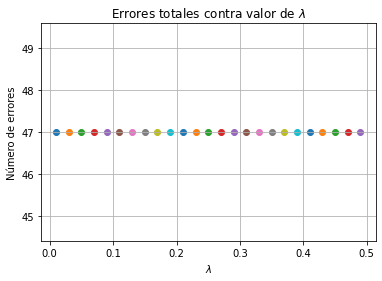

In [25]:
# Tenemos 6 clases diferentes.
priori = 1/6 
lambdas = []
val = 0.01
I = np.eye(np.shape(vNeutral_val)[0])

for i in range(1, 51, 2):
    lambdas.append((val*i))

# lambdas.append(val*4)

matriz_val = np.concatenate((vNeutral_val, vHappy_val, vSad_val, vFear_val, vAngry_val, vDisgust_val), axis=1)

contador_neutral = 0
contador_happy = 0
contador_sad = 0
contador_fear = 0
contador_angry = 0
contador_disgust = 0

errores_neutral = 0
errores_happy = 0
errores_sad = 0
errores_fear = 0
errores_angry = 0
errores_disgust = 0

errores = 0

for l in lambdas:
    regu = l*I
    for i in range(np.shape(matriz_val)[1]):

        dato = np.array(np.matrix(matriz_val[:,i])).T

        likelihood1 = gauss(dato, mu_neutral, C_neutral + regu)
        likelihood2 = gauss(dato, mu_happy, C_happy + regu)
        likelihood3 = gauss(dato, mu_sad, C_sad + regu)
        likelihood4 = gauss(dato, mu_fear, C_fear + regu)
        likelihood5 = gauss(dato, mu_angry, C_angry + regu)
        likelihood6 = gauss(dato, mu_disgust, C_disgust + regu)

        c_1 = float(likelihood1*priori)
        c_2 = float(likelihood2*priori)
        c_3 = float(likelihood3*priori)
        c_4 = float(likelihood4*priori)
        c_5 = float(likelihood5*priori)
        c_6 = float(likelihood6*priori)

        c = [c_1, c_2, c_3, c_4, c_5, c_6]
        c_hat = max(c)

        if i < cNeutral_val:
            if c_hat == c_1:
                contador_neutral += 1
            else:
                errores_neutral += 1
        if i >= cNeutral_val and i < cHappy_val:
            if c_hat == c_2:
                contador_happy += 1
            else:
                errores_happy += 1
        if i >= cHappy_val and i < cSad_val:
            if c_hat == c_3:
                contador_sad += 1
            else:
                errores_sad += 1
        if i >= cSad_val and i < cFear_val:
            if c_hat == c_4:
                contador_fear += 1
            else: 
                errores_fear += 1
        if i >= cFear_val and i < cAngry_val:
            if c_hat == c_5:
                contador_angry += 1
            else:
                errores_angry += 1
        if i >= cAngry_val and i < cDisgust_val:
            if c_hat == c_6:
                contador_disgust += 1
            else:
                errores_disgust += 1

    errores_totales = errores_neutral + errores_happy + errores_sad + errores_fear + errores_angry + errores_disgust
    error_val = errores_totales/np.shape(matriz_val)[1]
    
    plt.scatter(l, errores_totales)
    plt.grid(b=True)
    plt.title('Errores totales contra valor de $\lambda$')
    plt.xlabel('$\lambda$')
    plt.ylabel('Número de errores')

    errores_neutral = 0
    errores_happy = 0
    errores_sad = 0

    errores_fear = 0
    errores_angry = 0
    errores_disgust = 0

    contador_neutral = 0
    contador_happy = 0
    contador_sad = 0
    contador_fear = 0
    contador_angry = 0
    contador_disgust = 0

    errores_totales = 0
            
    

# f) Con el valor de λ seleccionado en el enunciado e), en los datos de prueba calcule el porcentaje de error de clasificación y la matriz de confusión. Comente los resultados obtenidos. Analice en detalle la confusión del clasificador entre clases.

Como estamos obteniendo la misma cantidad de errores sin importar qué $\lambda$ se use, elegimos uno cualquiera.

In [26]:
# Elegiremos un valor de lambda = 0.04

priori = 1/6 
regu_opt = 0.04*I
I = np.eye(np.shape(vNeutral_test)[0])

matriz_test = np.concatenate((vNeutral_test, vHappy_test, vSad_test, vFear_test, vAngry_test, vDisgust_test), axis=1)

# Contadores para saber cuántas clasificaciones correctas se lograron
contador_neutral = 0
contador_happy = 0
contador_sad = 0
contador_fear = 0
contador_angry = 0
contador_disgust = 0

# Contadores para saber cuántas clasificaciones equivocadas por clase se obtuvieron (para construir la matriz de confusión).
# La nomenclatura es: e_clasequeera_claseenlaqueseclasificó
e_neutral_happy = 0
e_neutral_sad = 0
e_neutral_fear = 0
e_neutral_angry = 0
e_neutral_disgust = 0

e_happy_neutral = 0
e_happy_sad = 0
e_happy_fear = 0
e_happy_angry = 0
e_happy_disgust = 0

e_sad_neutral = 0
e_sad_happy = 0
e_sad_fear = 0
e_sad_angry = 0
e_sad_disgust = 0

e_fear_neutral = 0
e_fear_happy = 0
e_fear_sad = 0
e_fear_angry = 0
e_fear_disgust = 0

e_angry_neutral = 0
e_angry_happy = 0
e_angry_sad = 0
e_angry_fear = 0
e_angry_disgust = 0

e_disgust_neutral = 0
e_disgust_happy = 0
e_disgust_sad = 0
e_disgust_fear = 0
e_disgust_angry = 0

for i in range(np.shape(matriz_test)[1]):

    dato = np.array(np.matrix(matriz_test[:,i])).T

    likelihood1 = gauss(dato, mu_neutral, C_neutral + regu_opt)
    likelihood2 = gauss(dato, mu_happy, C_happy + regu_opt)
    likelihood3 = gauss(dato, mu_sad, C_sad + regu_opt)
    likelihood4 = gauss(dato, mu_fear, C_fear + regu_opt)
    likelihood5 = gauss(dato, mu_angry, C_angry + regu_opt)
    likelihood6 = gauss(dato, mu_disgust, C_disgust + regu_opt)

    c_1 = float(likelihood1*priori)
    c_2 = float(likelihood2*priori)
    c_3 = float(likelihood3*priori)
    c_4 = float(likelihood4*priori)
    c_5 = float(likelihood5*priori)
    c_6 = float(likelihood6*priori)

    c = [c_1, c_2, c_3, c_4, c_5, c_6]
    c_hat = max(c)

    if i < cNeutral_test:
        if c_hat == c_1:
            contador_neutral += 1
        elif c_hat == c_2:
            e_neutral_happy += 1
        elif c_hat == c_3:
            e_neutral_sad += 1
        elif c_hat == c_4:
            e_neutral_fear += 1
        elif c_hat == c_5:
            e_neutral_angry += 1
        elif c_hat == c_6:
            e_neutral_disgust += 1
    if i >= cNeutral_test and i < cHappy_test:
        if c_hat == c_1:
            e_happy_neutral += 1
        elif c_hat == c_2:
            contador_happy += 1
        elif c_hat == c_3:
            e_happy_sad += 1
        elif c_hat == c_4:
            e_happy_fear += 1
        elif c_hat == c_5:
            e_happy_angry += 1
        elif c_hat == c_6:
            e_happy_disgust += 1
    if i >= cHappy_test and i < cSad_test:
        if c_hat == c_1:
            e_sad_neutral += 1
        elif c_hat == c_2:
            e_sad_happy += 1
        elif c_hat == c_3:
            contador_sad += 1
        elif c_hat == c_4:
            e_sad_fear += 1
        elif c_hat == c_5:
            e_sad_angry += 1
        elif c_hat == c_6:
            e_sad_disgust += 1
    if i >= cSad_test and i < cFear_test:
        if c_hat == c_1:
            e_fear_neutral += 1
        elif c_hat == c_2:
            e_fear_happy += 1
        elif c_hat == c_3:
            e_fear_sad += 1
        elif c_hat == c_4:
            contador_fear += 1
        elif c_hat == c_5:
            e_fear_angry += 1
        elif c_hat == c_6:
            e_fear_disgust += 1
    if i >= cFear_test and i < cAngry_test:
        if c_hat == c_1:
            e_angry_neutral += 1
        elif c_hat == c_2:
            e_angry_happy += 1
        elif c_hat == c_3:
            e_angry_sad += 1
        elif c_hat == c_4:
            e_angry_fear += 1
        elif c_hat == c_5:
            contador_angry += 1
        elif c_hat == c_6:
            e_angry_disgust += 1
    if i >= cAngry_test and i < cDisgust_test:
        if c_hat == c_1:
            e_disgust_neutral += 1
        elif c_hat == c_2:
            e_disgust_happy += 1
        elif c_hat == c_3:
            e_disgust_sad += 1
        elif c_hat == c_4:
            e_disgust_fear += 1
        elif c_hat == c_5:
            contador_disgust += 1
        elif c_hat == c_6:
            contador_disgust += 1

# Total de errores al clasificar por clase. Nomenclatura: e_total_clase
e_total_neutral = e_neutral_happy + e_neutral_sad + e_neutral_fear + e_neutral_angry + e_neutral_disgust
e_total_happy = e_happy_neutral + e_happy_sad + e_happy_fear + e_happy_angry + e_happy_disgust
e_total_sad = e_sad_neutral + e_sad_happy + e_sad_fear + e_sad_angry + e_sad_disgust
e_total_fear = e_fear_neutral + e_fear_happy + e_fear_sad + e_fear_angry + e_fear_disgust
e_total_angry = e_angry_neutral + e_angry_happy + e_angry_sad + e_angry_fear + e_angry_disgust
e_total_disgust = e_disgust_neutral + e_disgust_happy + e_disgust_sad + e_disgust_fear + e_disgust_angry

# Porcentaje de errores por clase
error_neutral = e_total_neutral/np.shape(vNeutral_test)[1]
error_happy = e_total_happy/np.shape(vHappy_test)[1]
error_sad = e_total_sad/np.shape(vSad_test)[1]
error_fear = e_total_fear/np.shape(vFear_test)[1]
error_angry = e_total_angry/np.shape(vAngry_test)[1]
error_disgust = e_total_disgust/np.shape(vDisgust_test)[1]

clasificaciones_correctas = contador_neutral + contador_happy + contador_sad + contador_fear + contador_angry + contador_disgust
correctas = clasificaciones_correctas/np.shape(matriz_test)[1]
errores_totales = e_total_neutral + e_total_happy + e_total_sad + e_total_fear + e_total_angry + e_total_disgust
error_test = errores_totales/np.shape(matriz_test)[1]

print(f'Num. de clasificaciones correctas: {clasificaciones_correctas}')
print(f'Clasificaciones correctas datos de prueba: {np.round(correctas, 4)*100}%\n')
print(f'Num. total de errores: {errores_totales}')
print(f'ERROR datos de prueba: {np.round(error_test, 4)*100}% \n')

confusion = np.array([[contador_neutral, e_neutral_happy, e_neutral_sad, e_neutral_fear, e_neutral_angry, e_neutral_disgust],
                      [e_happy_neutral, contador_happy, e_happy_sad, e_happy_fear, e_happy_angry, e_happy_disgust],
                      [e_sad_neutral, e_sad_happy, contador_sad, e_sad_fear, e_sad_angry, e_sad_disgust],
                      [e_fear_neutral, e_fear_happy, e_fear_sad, contador_fear, e_fear_angry, e_fear_disgust],
                      [e_angry_neutral, e_angry_happy, e_angry_sad, e_angry_fear, contador_angry, e_angry_disgust],
                      [e_disgust_neutral, e_disgust_happy, e_disgust_sad, e_disgust_fear, e_disgust_angry, contador_disgust]])

df = pd.DataFrame(confusion, columns = ['Neutral','Happy','Sad','Fear', 'Angry', 'Disgust'], index = ['Neutral','Happy','Sad','Fear', 'Angry', 'Disgust'])

print(f'Matriz de confusión: \n {df} \n')
print(f'Porcentaje de error neutral: {e_total_neutral}/{np.shape(vNeutral_test)[1]} = {np.round(error_neutral, 4)*100}%\n')
print(f'Porcentaje de error happy: {e_total_happy}/{np.shape(vHappy_test)[1]} = {np.round(error_happy, 4)*100}%\n')
print(f'Porcentaje de error sad: {e_total_sad}/{np.shape(vSad_test)[1]} = {np.round(error_sad, 4)*100}%\n')
print(f'Porcentaje de error fear: {e_total_fear}/{np.shape(vFear_test)[1]} = {np.round(error_fear, 4)*100}%\n')
print(f'Porcentaje de error angry: {e_total_angry}/{np.shape(vAngry_test)[1]} = {np.round(error_angry, 4)*100}%\n')
print(f'Porcentaje de error disgust: {e_total_disgust}/{np.shape(vDisgust_test)[1]} = {np.round(error_disgust, 4)*100}%\n')


Num. de clasificaciones correctas: 95
Clasificaciones correctas datos de prueba: 65.07%

Num. total de errores: 51
ERROR datos de prueba: 34.93% 

Matriz de confusión: 
          Neutral  Happy  Sad  Fear  Angry  Disgust
Neutral       14      0    0     3      7        0
Happy          0     21    0     1      0        5
Sad            6      0    5     3      3        3
Fear           7      0    1    22      0        0
Angry          3      0    2     0     16        1
Disgust        5      0    1     0      0       17 

Porcentaje de error neutral: 10/24 = 41.67%

Porcentaje de error happy: 6/27 = 22.220000000000002%

Porcentaje de error sad: 15/20 = 75.0%

Porcentaje de error fear: 8/30 = 26.669999999999998%

Porcentaje de error angry: 6/22 = 27.27%

Porcentaje de error disgust: 6/23 = 26.090000000000003%



En general, se puede observar que la clase más problemática es la clase Sad, pues tiene le valor más alto de error. En general, esta clase se confunde más que todo con la clase Neutral y después con la clase Angry. La clase Disgust también suele confundirse más que todo con la clase Neutral. La clases que mejor se clasifican son las clases Happy y Angry, pues son las que tienen los menores porcentajes de error de clasificación.

Se observa que para los datos de prueba, el porcentaje de error siempre está entre el 30% y el 35% (cada vez que se corre el script se distribuyen los datos de manera distinta), que no es muy bueno, aunque tampoco está tan mal. 